The VideoFrameGenerator I created can be installed via pip command:

In [ ]:
import os
os.mkdir("Dataset") 
os.mkdir("Testset")

In [ ]:
# Download dataset
%cd /content/Dataset
!curl -L "https://api.jl-workshop.com/v2/csdlg/download?h=17e9a93ff1&url=https%3A%2F%2Fwww.mediafire.com%2Ffile%2Fb0ugfou7cpwctjc%2FDataset.rar%2Ffile" > Dataset.rar; unrar x Dataset.rar; rm Dataset.rar
%cd /content/Testset
!curl -L "https://api.jl-workshop.com/v2/csdlg/download?h=497e9a3e18&url=https%3A%2F%2Fwww.mediafire.com%2Ffile%2F8eael79sy6qj9vy%2FTestset.rar%2Ffile" > Testset.rar; unrar x Testset.rar; rm Testset.rar



/content/Dataset
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   111  100   111    0     0    128      0 --:--:-- --:--:-- --:--:--   128
100 2675M  100 2675M    0     0  22.0M      0  0:02:01  0:02:01 --:--:-- 18.9M

UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from Dataset.rar

Creating    Approach                                                  OK
Extracting  Approach/Approach10.mp4                                        0%  OK 
Extracting  Approach/Approach11.mp4                                        0%  OK 
Extracting  Approach/Approach12.mp4                                        0%  OK 
Extracting  Approach/Approach13.mp4                                        0%  OK 
Extracting  Approach/Approach14.mp4                                        0%  OK 
Extracting  Approach/Approach15.mp4 

In [ ]:
%cd /content
!rm -r chkp/
!rm -r logs/

/content


In [ ]:
!pip install keras-video-generators



  Created wheel for keras-video-generators: filename=keras_video_generators-1.0.14-cp37-none-any.whl size=12884 sha256=1f249dda45608f75e2c717472c0192613e2273ab1a5e8fa5aa74b8afbff63e15
  Stored in directory: /root/.cache/pip/wheels/20/b7/76/8674d46fc4777c09e5aa7b065d4e356d90f12ec409a6144bbb
Successfully built keras-video-generators


On my computer, I created a directory named “videos” with 3 sub-directories named with class names.
I can now try my generator included in keras_generator package:

In [ ]:
%cd /content/
import os
import glob
import keras
from keras_video import VideoFrameGenerator
# use sub directories names as classes
classes = [i.split(os.path.sep)[1] for i in glob.glob('Dataset/*')]
classes.sort()
# some global params
SIZE = (112, 112)
CHANNELS = 3
NBFRAME = 10
BS = 8
# pattern to get videos and classes
glob_pattern='Dataset/{classname}/*.mp4'
# for data augmentation
data_aug = keras.preprocessing.image.ImageDataGenerator(
    zoom_range=.1,
    horizontal_flip=True,
    rotation_range=8,
    width_shift_range=.2,
    height_shift_range=.2)
# Create video frame generator
train = VideoFrameGenerator(
    classes=classes, 
    glob_pattern=glob_pattern,
    nb_frames=NBFRAME,
    split_val=.2,
    shuffle=True,
    batch_size=BS,
    target_shape=SIZE,
    nb_channel=CHANNELS,
    transformation=data_aug,
    use_frame_cache=False)

import keras_video.utils
valid = train.get_validation_generator()

/content
class Approach, validation count: 24, train count: 100
class ChangeLane, validation count: 29, train count: 119
class Follow, validation count: 27, train count: 111
class FreeRide, validation count: 20, train count: 84
Total data: 4 classes for 414 files for train
Total data: 4 classes for 100 files for validation


To get the validation data:

Here are samples from train generator — you can use:

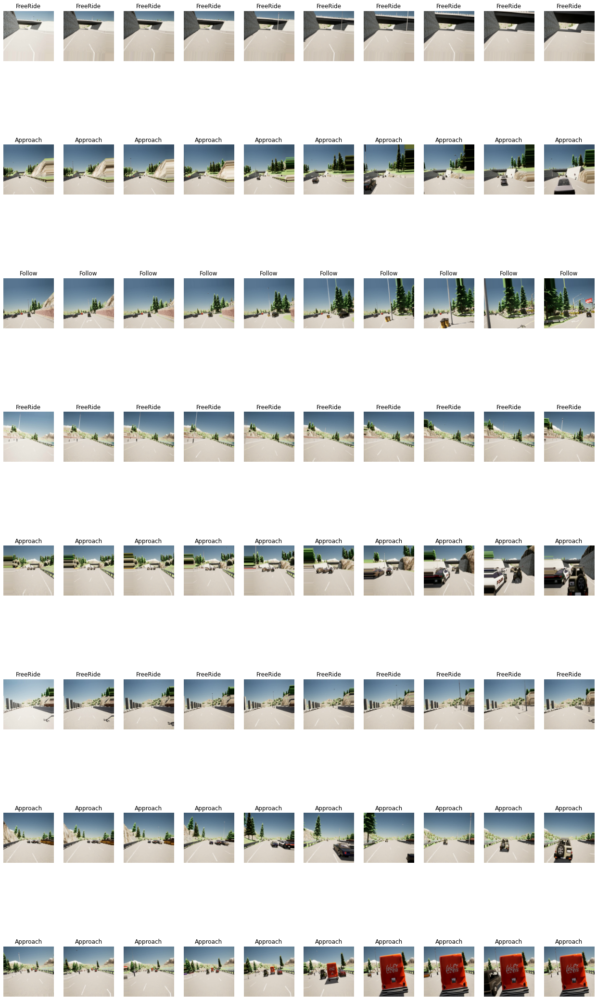

In [ ]:
import keras_video.utils
keras_video.utils.show_sample(train)

So, we need to create that ConvNet. I recommend creating a function that returns the model. Here, I’m using a simple model. I made several convolutions with batch normalization.

In [ ]:
from keras.layers import Conv2D, BatchNormalization, \
    MaxPool2D, GlobalMaxPool2D
def build_convnet(shape=(112, 112, 3)):
    momentum = .9
    model = keras.Sequential()
    model.add(Conv2D(64, (3,3), input_shape=shape,
        padding='same', activation='relu'))
    model.add(Conv2D(64, (3,3), padding='same', activation='relu'))
    model.add(BatchNormalization(momentum=momentum))
    
    model.add(MaxPool2D())
    
    model.add(Conv2D(128, (3,3), padding='same', activation='relu'))
    model.add(Conv2D(128, (3,3), padding='same', activation='relu'))
    model.add(BatchNormalization(momentum=momentum))
    
    model.add(MaxPool2D())
    
    model.add(Conv2D(256, (3,3), padding='same', activation='relu'))
    model.add(Conv2D(256, (3,3), padding='same', activation='relu'))
    model.add(BatchNormalization(momentum=momentum))
    
    model.add(MaxPool2D())
    
    model.add(Conv2D(512, (3,3), padding='same', activation='relu'))
    model.add(Conv2D(512, (3,3), padding='same', activation='relu'))
    model.add(BatchNormalization(momentum=momentum))
    
    # flatten...
    model.add(GlobalMaxPool2D())
    return model

OK, it’s now time to build the time distributed model. I was using LSTM that is very efficient, but I finally use GRU that is conceptually the same but using less memory, but the cost is that it is less efficient. But one more time, we’re testing…

In [ ]:
from keras.layers import TimeDistributed, GRU, Dense, Dropout
def action_model(shape=(NBFRAME, 112, 112, CHANNELS), nbout=3):
    # Create our convnet with (112, 112, 3) input shape
    convnet = build_convnet(shape[1:])
    
    # then create our final model
    model = keras.Sequential()
    # add the convnet with (5, 112, 112, 3) shape
    model.add(TimeDistributed(convnet, input_shape=shape))
    # here, you can also use GRU or LSTM
    model.add(GRU(64))
    # and finally, we make a decision network
    model.add(Dense(1024, activation='relu'))
    model.add(Dropout(.5))
    model.add(Dense(512, activation='relu'))
    model.add(Dropout(.5))
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(.5))
    model.add(Dense(64, activation='relu'))
    model.add(Dense(nbout, activation='softmax'))
    return model

Because the dataset is not very large, I recommend using Dropout to avoid overfitting (it will happen anyway… but at least we reduce the problem)
Let’s create the model:

In [ ]:
INSHAPE=(NBFRAME,) + SIZE + (CHANNELS,) # (5, 112, 112, 3)
model = action_model(INSHAPE, len(classes))
optimizer = keras.optimizers.Adam(0.001)
model.compile(
    optimizer,
    'categorical_crossentropy',
    metrics=['acc']
)

# #Training





In [ ]:
EPOCHS=100
# create a "chkp" directory before to run that
# because ModelCheckpoint will write models inside
#keras.callbacks.EarlyStopping(monitor="acc", patience=10),
callbacks = [
    keras.callbacks.ReduceLROnPlateau(verbose=1),
    keras.callbacks.ModelCheckpoint(
        'chkp/weights.{epoch:02d}-{val_loss:.2f}.hdf5',
        verbose=1),
        keras.callbacks.TensorBoard(log_dir='logs')
]
model.fit(
    train,
    validation_data=valid,
    verbose=1,
    epochs=EPOCHS,
    callbacks=callbacks
)

Epoch 1/100
51/51 [==============================] - 272s 5s/step - loss: 1.4576 - acc: 0.2525 - val_loss: 1.3627 - val_acc: 0.3229

Epoch 00001: saving model to chkp/weights.01-1.36.hdf5
Epoch 2/100
51/51 [==============================] - 21s 412ms/step - loss: 1.4411 - acc: 0.2669 - val_loss: 1.3542 - val_acc: 0.3438

Epoch 00002: saving model to chkp/weights.02-1.35.hdf5
Epoch 3/100
51/51 [==============================] - 17s 338ms/step - loss: 1.4124 - acc: 0.2786 - val_loss: 1.3306 - val_acc: 0.4271

Epoch 00003: saving model to chkp/weights.03-1.33.hdf5
Epoch 4/100
51/51 [==============================] - 17s 332ms/step - loss: 1.3314 - acc: 0.3590 - val_loss: 1.0759 - val_acc: 0.3854

Epoch 00004: saving model to chkp/weights.04-1.08.hdf5
Epoch 5/100
51/51 [==============================] - 17s 327ms/step - loss: 1.2021 - acc: 0.4435 - val_loss: 1.0985 - val_acc: 0.5000

Epoch 00005: saving model to chkp/weights.05-1.10.hdf5
Epoch 6/100
51/51 [==============================] -

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs
%reload_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 208), started 0:34:03 ago. (Use '!kill 208' to kill it.)

<IPython.core.display.Javascript object>

#   Testing

create testset 

In [ ]:
%cd /content/
import os
import glob
import keras
from keras_video import VideoFrameGenerator
# use sub directories names as classes
classes = [i.split(os.path.sep)[1] for i in glob.glob('Testset/*')]
classes.sort()
# some global params
#SIZE = (112, 112)
#CHANNELS = 3
#NBFRAME = 10
#BS = 8
# pattern to get videos and classes
glob_pattern='Testset/{classname}/*.mp4'
# for data augmentation
data_aug = keras.preprocessing.image.ImageDataGenerator(
    zoom_range=.1,
    horizontal_flip=True,
    rotation_range=8,
    width_shift_range=.2,
    height_shift_range=.2)
# Create video frame generator
test_gen = VideoFrameGenerator(
    classes=classes, 
    glob_pattern=glob_pattern,
    nb_frames=NBFRAME,
    shuffle=False,
    split_val=.99,
    batch_size=BS,
    target_shape=SIZE,
    nb_channel=CHANNELS,
    transformation=data_aug,
    use_frame_cache=False)

import keras_video.utils
test = test_gen.get_validation_generator()

/content
class Approach, validation count: 14, train count: 1
class ChangeLane, validation count: 14, train count: 1
class Follow, validation count: 14, train count: 1
class FreeRide, validation count: 15, train count: 1
Total data: 4 classes for 4 files for train
Total data: 4 classes for 57 files for validation


custom show_result method

In [ ]:
"""
Utils module to provide some nice functions to develop with Keras and
Video sequences.
"""

import numpy as np
import random as rnd
import matplotlib.pyplot as plt


def custom_show_sample(pred, g, index=0, random=False, row_width=22, row_height=5):
    """ Displays a batch using matplotlib.

    params:

    - g: keras video generator
    - index: integer index of batch to see (overriden if random is True)
    - random: boolean, if True, take a random batch from the generator
    - row_width: integer to give the figure height
    - row_height: integer that represents one line of image, it is multiplied by \
    the number of sample in batch.
    """
    total = len(g)
    sample = index
    batch_offset = BS*(index)

    assert index < len(g)
    sample = g[sample]
    sequences = sample[0]
    labels = sample[1]
    classes = ['Approach', 'ChangeLane', 'Follow', 'FreeRide']
    rows = len(sequences)
    index = 1
    fig = plt.figure(figsize=(row_width, row_height*rows))
    for batchid, sequence in enumerate(sequences):
        classid = np.argmax(labels[batchid])
        classname = g.classes[classid]
        cols = len(sequence)
        pred_acc = np.argmax(pred, axis=1)
        pred_index = pred_acc[batchid + batch_offset]
        for image in sequence:
            plt.subplot(rows, cols, index)
            plt.title(classname)
            plt.imshow(image)
            plt.annotate(classes[pred_index], xy=(30, 100))
            acc = pred[batchid + batch_offset]
            acc_str = []
            for i in range(len(acc)):
              k = "{:.2f}".format(acc[i])
              acc_str.append(float(k))
            plt.annotate(acc_str, xy=(30, 90))
            plt.axis('off')
            index += 1
    plt.show()


custom method for printing results

In [ ]:
def print_results(results):
  #print(results)
  result_class= np.argmax(results, axis=1)
  print(result_class)

  #print confidenc of each prediction
  seq = -1
  seq_batch = -1
  batch = 0
  classes = ['Approach', 'ChangeLane', 'Follow', 'FreeRide']


  for conf in results:
    seq = seq + 1
    seq_batch = seq_batch + 1
    if (seq % (BS ) == 0 and seq != 0):
      seq_batch = seq_batch - (BS )
    if (seq % (BS ) == 0 and seq != 0):
      batch = batch + 1
    #print('seq',seq)
    #print('seq_batch',seq_batch)
    #print('batch',batch)
    acc_str = []
    for i in range(len(conf)):
      k = "{:.2f}".format(conf[i])
      acc_str.append(float(k))
    print('sequence ',seq )
    classid = np.argmax(test[batch][1][seq_batch -1])
    print('correct class:', classes[classid], ' - ', 'prediction:', classes[result_class[seq]])
    print('confidence: ', acc_str)

Accuracy e visual output

7/7 [==============================] - 21s 4s/step - loss: 0.0793 - acc: 0.9643
[0 2 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2
 2 2 2 0 2 3 3 3 3 3 3 3 3 3 3 3 3 3 3]
sequence  0
correct class: Approach  -  prediction: Approach
confidence:  [0.94, 0.0, 0.06, 0.0]
sequence  1
correct class: Approach  -  prediction: Follow
confidence:  [0.2, 0.36, 0.39, 0.05]
sequence  2
correct class: Approach  -  prediction: Approach
confidence:  [0.96, 0.0, 0.04, 0.0]
sequence  3
correct class: Approach  -  prediction: Approach
confidence:  [0.96, 0.0, 0.04, 0.0]
sequence  4
correct class: Approach  -  prediction: Approach
confidence:  [0.95, 0.0, 0.05, 0.0]
sequence  5
correct class: Approach  -  prediction: Approach
confidence:  [0.94, 0.0, 0.06, 0.0]
sequence  6
correct class: Approach  -  prediction: Approach
confidence:  [0.94, 0.0, 0.06, 0.0]
sequence  7
correct class: Approach  -  prediction: Approach
confidence:  [0.94, 0.0, 0.06, 0.0]
sequence  8
correct class: Cha

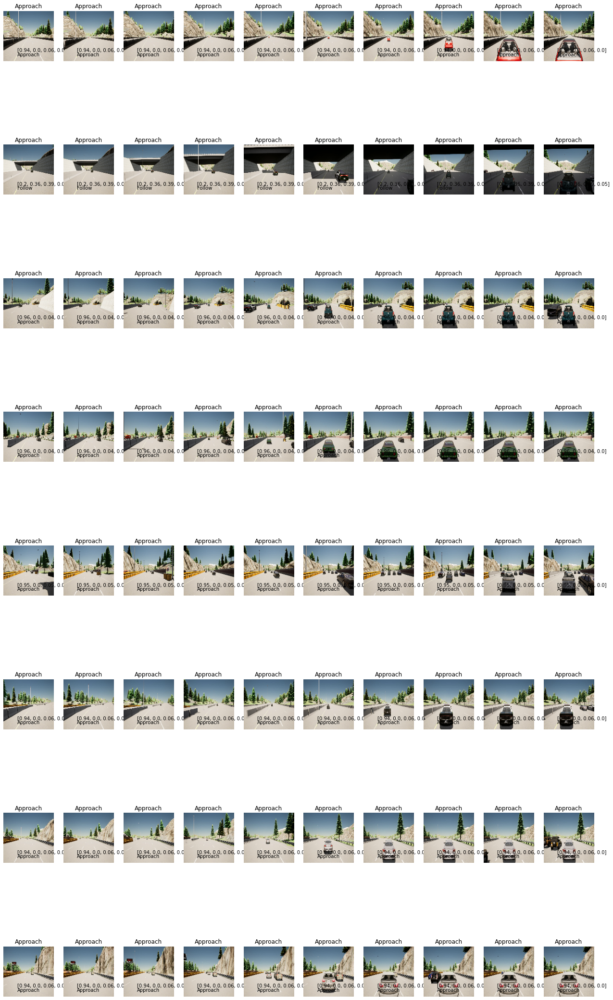

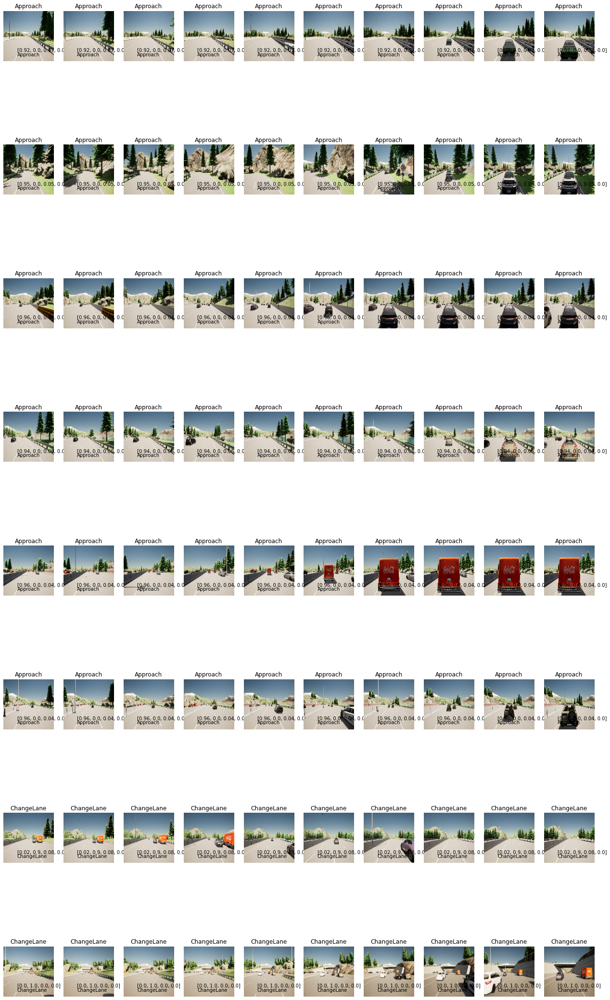

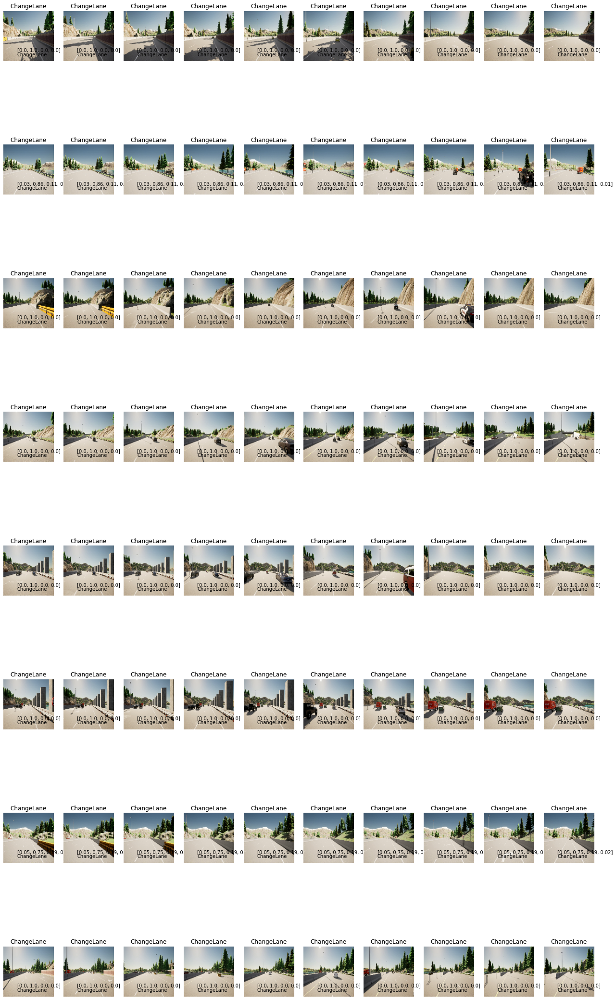

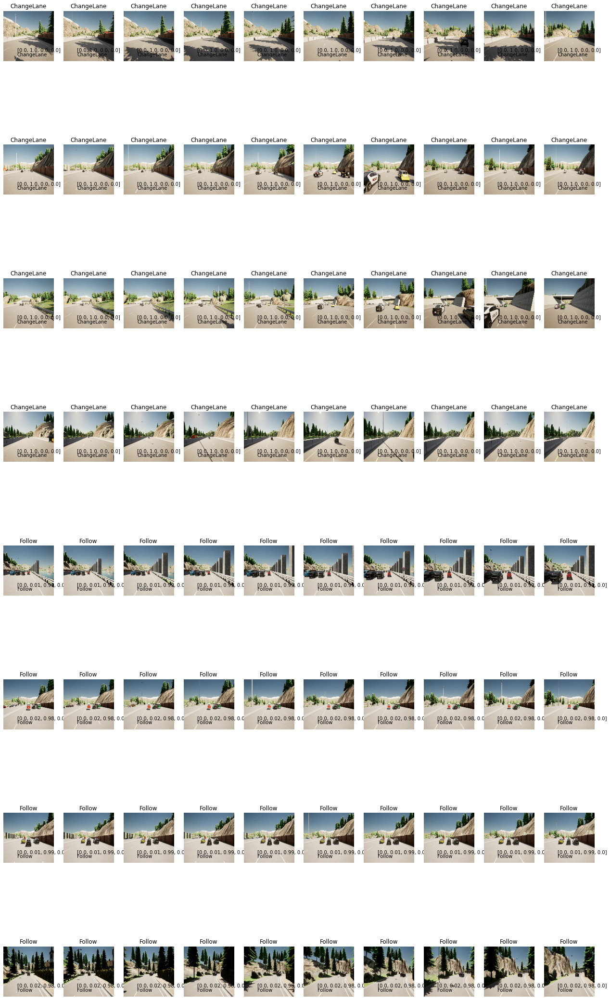

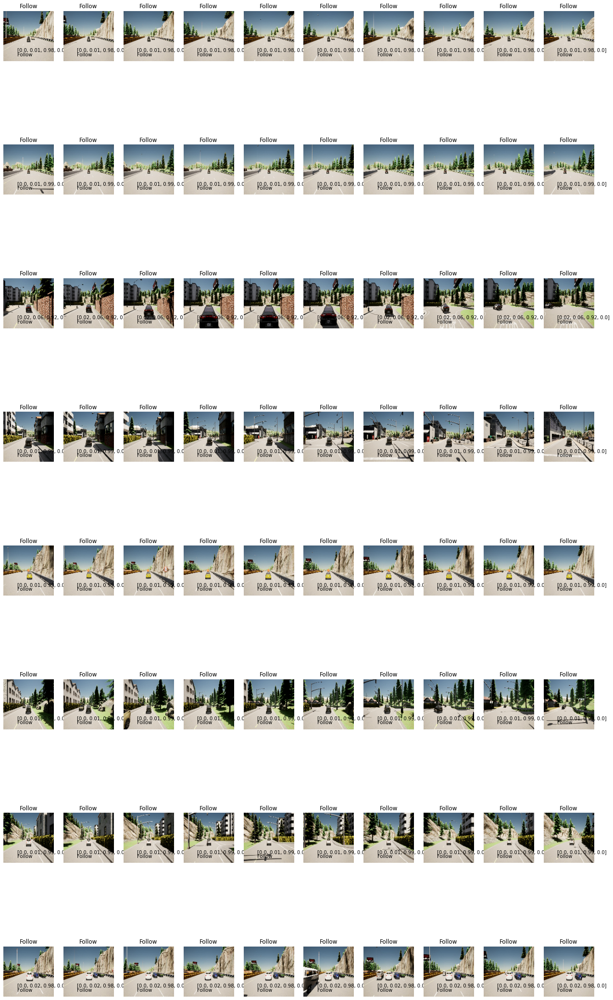

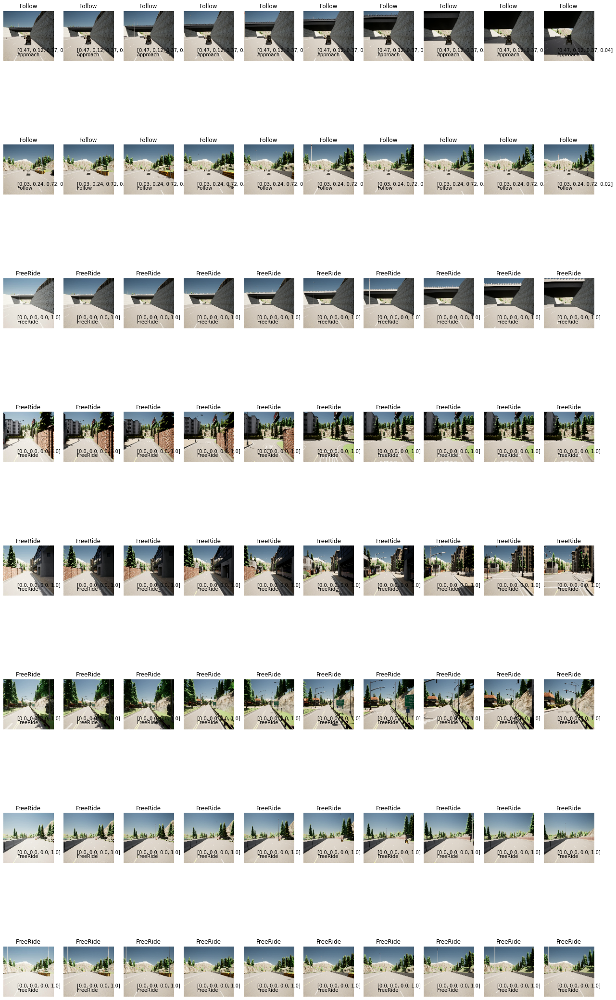

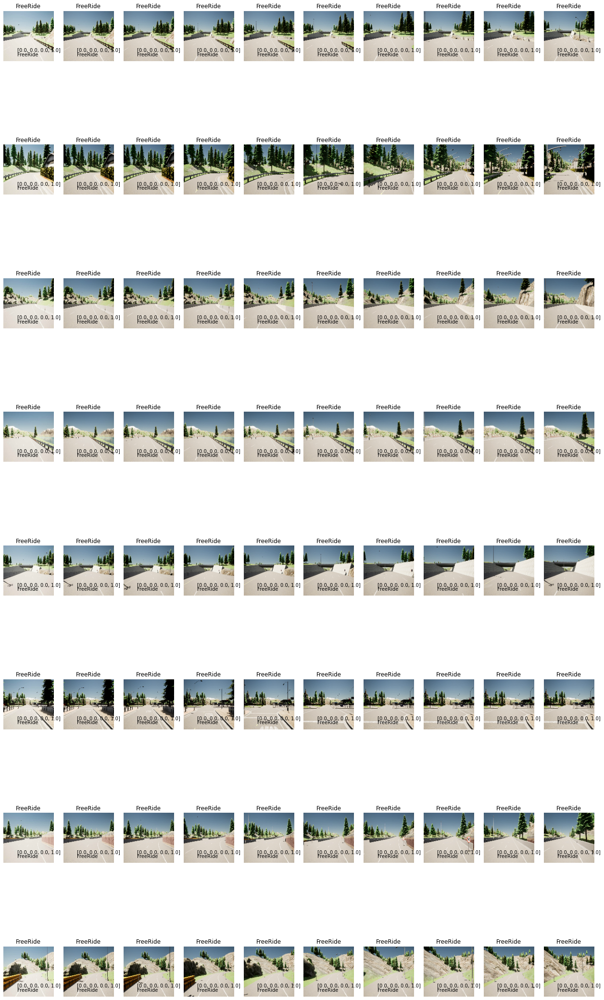

In [ ]:
import numpy as np
#compute and print average accuracy
accuracy = model.evaluate(test)
#compute and print predictions
results = model.predict(test)

#print results
print_results(results)
#print(test[0][1])
  
#show results
batch = len(test)
for i in range(batch):
  custom_show_sample(results, test,i)
